<a href="https://colab.research.google.com/github/ladofa/edu/blob/master/Example_card_finder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import cv2
import random
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
from tensorflow import keras
import json
from google.colab.patches import cv2_imshow

In [ ]:
!unzip -qq cards.zip

replace cards/train/cog/KakaoTalk_20210818_134550564.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
labels = {
    'id':0,
    'drive':1,
    'credit':2,
    'kangwon':3
}


In [ ]:
for root, dirs, filenames in os.walk('./cards'):
    for filename in filenames:
        first, last = os.path.splitext(filename)

        if last != '.jpg':
            continue
        
        json_path = os.path.join(root, first + '.json')
        if not os.path.exists(json_path):
            continue
        
        data = json.load(open(json_path, 'r'))
        if data['shapes'][0]['label'] not in labels:
            print(data['shapes'][0]['label'], json_path)

In [ ]:
label_alt = {
    'credit2':'credit',
    'credit1':'credit',
    'card':'credit',
}

In [ ]:
def sort_points(points):
    s = points.sum(axis=1)
    lt = s.argmin()
    rb = s.argmax()
    m = points[:, 1] - points[:, 0]
    lb = m.argmax()
    rt = m.argmin()
    if len({lt, rb, lb, rt}) < 4:
        return None
    return points[[lt, rt, rb, lb]]

In [ ]:
cards_data_train = []
cards_data_valid = []
for root, dirs, filenames in os.walk('./cards'):
    for filename in filenames:
        first, last = os.path.splitext(filename)

        if last != '.jpg':
            continue
        
        json_path = os.path.join(root, first + '.json')
        if not os.path.exists(json_path):
            continue
        
        jpg_path = os.path.join(root, filename)
        data = json.load(open(json_path, 'r'))
        label_txt = data['shapes'][0]['label']
        if label_txt in label_alt:
            label_txt = label_alt[label_txt]
        label = labels[label_txt]
        # if label == 2:
        #     continue

        points = data['shapes'][0]['points']
        points = np.array(points, dtype=np.float32)
        points = sort_points(points)
        points = points.reshape(-1)

        if 'train' in root:
            cards_data_train.append((jpg_path, label, points))
        else:
            cards_data_valid.append((jpg_path, label, points))

In [ ]:
image =cv2.imread(cards_data_train[0][0])
print(cards_data_train[0])
image.shape

('./cards/train/kkm/┴ж╕ё ╛°└╜.jpg', 3, array([437.11765, 586.2353 , 929.7647 , 570.05884, 960.64703, 883.2941 ,
       444.47058, 911.2353 ], dtype=float32))


(1152, 1280, 3)

In [ ]:
print(len([item for item in cards_data_valid if item[1] == 3]))

2


In [ ]:
def int64_feature(value):
  return tf.train.Feature(int64_list=tf.train.Int64List(value=value))

def bytes_feature(value):
  return tf.train.Feature(bytes_list=tf.train.BytesList(value=value))

def floats_feature(value):
  return tf.train.Feature(float_list=tf.train.FloatList(value=value))

def write_tfrecord(cards_data, tfrecord_path):
    writer = tf.io.TFRecordWriter(tfrecord_path)
    for jpg_path, label, points in cards_data:
        file = open(jpg_path, 'rb')
        feat_dict = {}
        feat_dict['image'] = bytes_feature([file.read()])
        feat_dict['label'] = int64_feature([label])
        feat_dict['points'] = floats_feature(points)
        file.close()

        example = tf.train.Example(features=tf.train.Features(feature=feat_dict))
        writer.write(example.SerializeToString())
    writer.close()
    
write_tfrecord(cards_data_train, 'train.tfrecord')
write_tfrecord(cards_data_valid, 'valid.tfrecord')

In [ ]:
len(cards_data_valid)

11

In [ ]:
def read_tfrecord(example):
    tfrecord_format = (
        {
            'image':tf.io.FixedLenFeature([], tf.string),
            'label':tf.io.FixedLenFeature([], tf.int64),
            'points':tf.io.FixedLenFeature([8], tf.float32)
        }
    )
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = tf.io.decode_jpeg(example['image'])
    label = example['label']
    points = example['points']
    return image, label, points

dataset_train = tf.data.TFRecordDataset('train.tfrecord')
dataset_valid = tf.data.TFRecordDataset('valid.tfrecord')
dataset_train = dataset_train.map(read_tfrecord)
dataset_valid = dataset_valid.map(read_tfrecord)

In [ ]:
len(list(dataset_valid))

11

In [ ]:
def generator_train():
    for path, label, points in cards_data_train:
        image = cv2.imread(path)
        label = np.array(label, dtype=np.int32)
        yield (image, label, points)

def generator_valid():
    for path, label, points in cards_data_valid:
        image = cv2.imread(path)
        label = np.array(label, dtype=np.int32)
        yield (image, label, points)

In [ ]:
dataset_train = tf.data.Dataset.from_generator(
    generator_train,
    (tf.uint8, tf.int32, tf.float32),
    ((None, None, 3), (), (8,))
    )

dataset_valid = tf.data.Dataset.from_generator(
    generator_valid,
    (tf.uint8, tf.int32, tf.float32),
    ((None, None, 3), (), (8,))
    )


In [ ]:
def draw_points(image, points, pixel=True):
    if type(image) == np.ndarray:
        image = image.copy()
        points = points.copy()
    else:
        image = image.numpy()
        points = points.numpy()
    if not pixel:
        h, w, _ = image.shape
        points = np.int32(points * ([w, h] * 4))
    pts = points.reshape([-1, 2]).astype(np.int32)
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 255)]
    for i in range(4):
        i2 = (i + 1) % 4
        cv2.line(image, tuple(pts[i]), tuple(pts[i2]), colors[i], 3)
    return image

asdf :  (1152, 1280, 3)


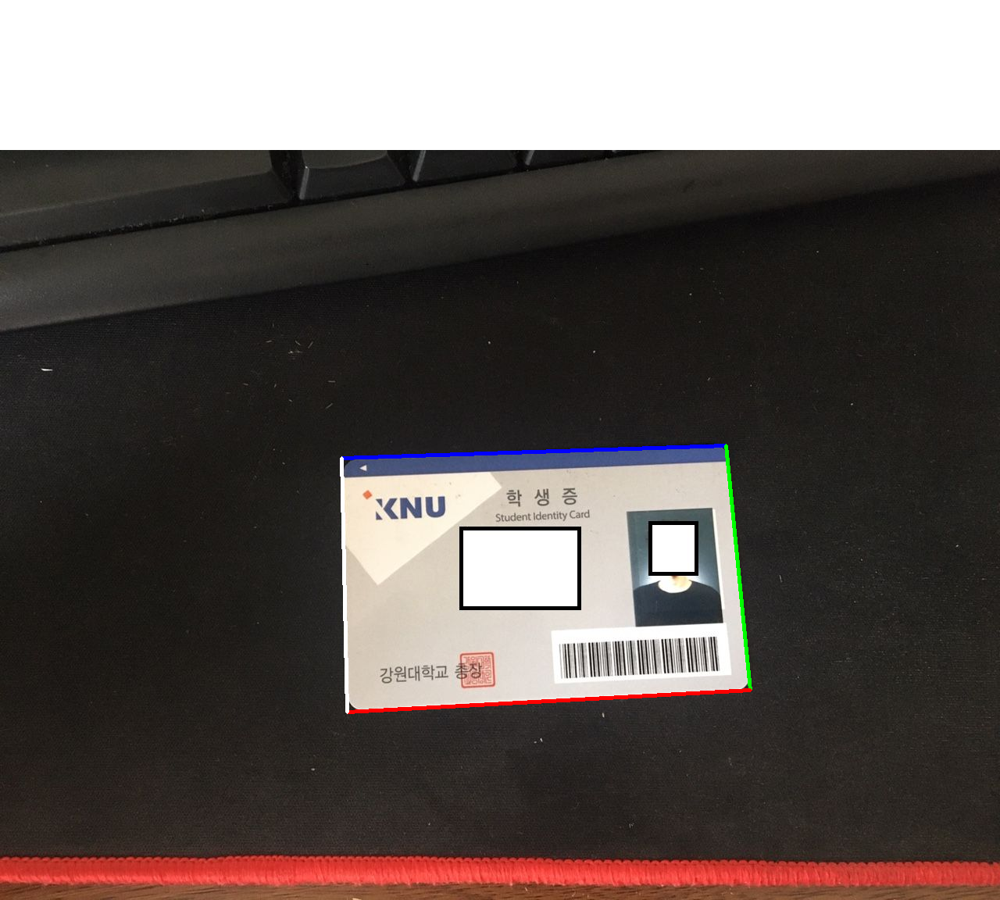

tf.Tensor(3, shape=(), dtype=int32)
(1152, 1280, 3)
asdf :  (1440, 810, 3)


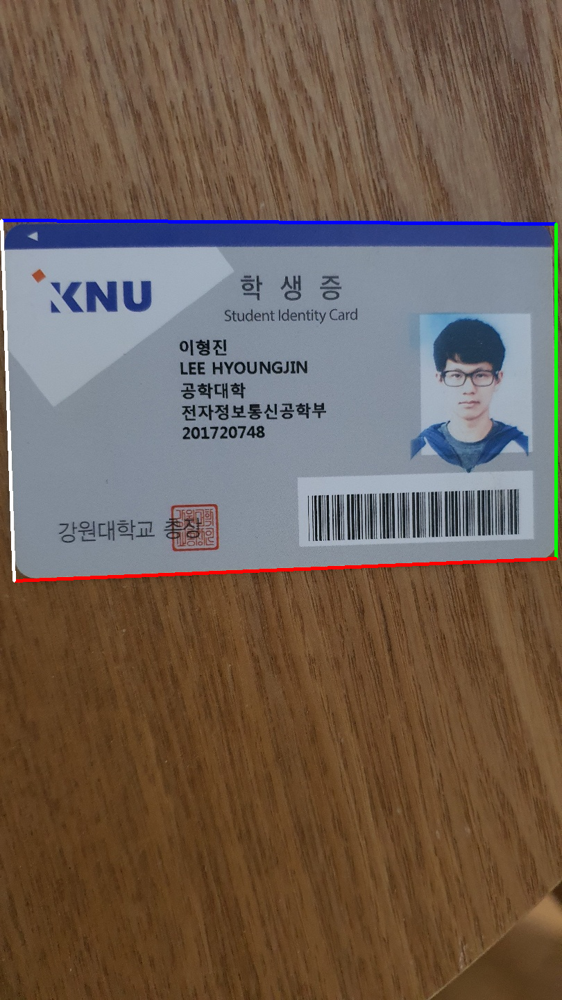

tf.Tensor(3, shape=(), dtype=int32)
(1440, 810, 3)
asdf :  (3024, 4032, 3)


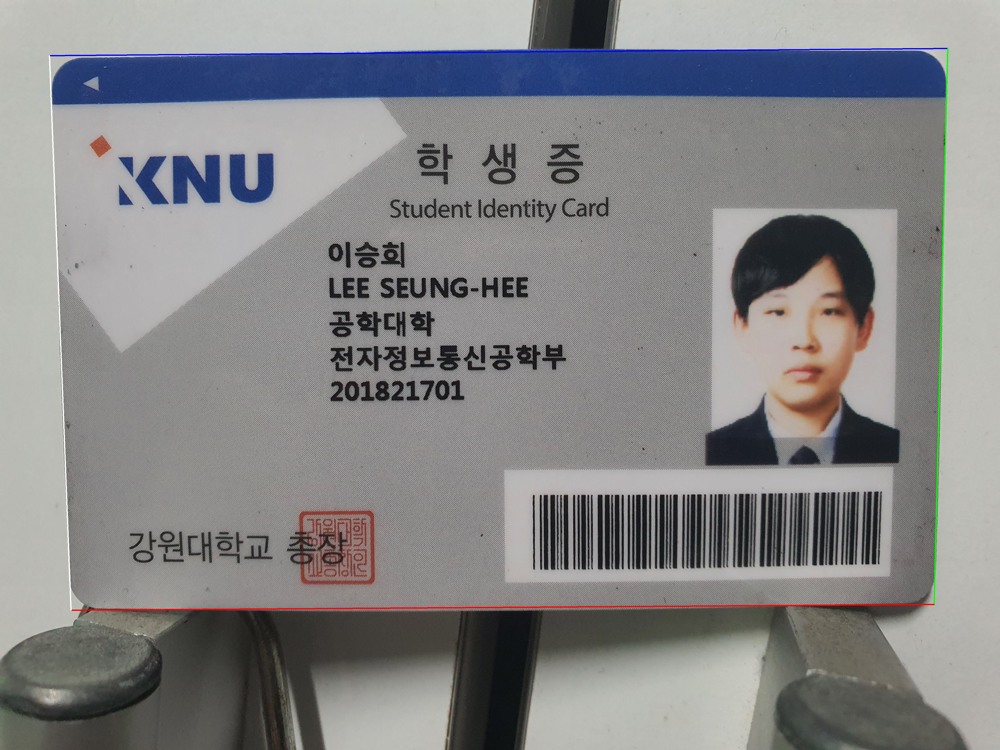

tf.Tensor(3, shape=(), dtype=int32)
(3024, 4032, 3)


In [ ]:
for image, label, points in dataset_train.take(3):
    print('asdf : ', image.shape)
    dst = draw_points(image, points)
    cv2_imshow(dst)
    print(label)
    print(image.shape)

In [ ]:
import random

def random_geometry(image, points, image_shape, target_size):
    width, height = target_size

    card_width = width * (0.75 + random.random() * 0.1)
    card_height = card_width * (5.4 / 8.6)
    center_x = width * (0.45 + random.random() * 0.1)
    center_y = height * (0.45 + random.random() * 0.1)

    x0 = center_x - card_width / 2
    y0 = center_y - card_height / 2
    x1 = center_x + card_width / 2
    y1 = center_y + card_height / 2

    #--코너점
    corners = np.array(
        [
            [x0, y0, 1],
            [x1, y0, 1],
            [x1, y1, 1],
            [x0, y1, 1]
        ], dtype=np.float32)

    #-- 회전 + (스케일)
    aug_angle = random.uniform(-4, 4)
    #ori_width is center of nu_image
    rot_matrix = cv2.getRotationMatrix2D((width // 2, height // 2), aug_angle, 1.0).astype(np.float32)
    corners = corners @ rot_matrix.T

    #-- 랜덤 추가
    corners += np.random.randn(4, 2) * (width / 100)

    #-- 호모그래피
    h = cv2.getPerspectiveTransform(points.reshape(4, 2), corners)
    dst_image = cv2.warpPerspective(image, h, target_size)
    dst_points = corners.reshape([-1]).astype(np.float32)

    return dst_image, dst_points
    
def random_salt_and_papper(image):
    #salt and papper
    width = image.shape[1]
    height = image.shape[0]
    
    salts = [[0, 0, 0], [255, 255, 255], [0, 0, 255], [0, 255, 0], [255, 0, 0]]

    for salt in salts:
        if random.random() < 0.1:
            salt_count = int(width * height * 0.01 * random.random())
            y_coord = np.random.randint(0, height, [salt_count])
            x_coord = np.random.randint(0, width, [salt_count])
            image[(y_coord, x_coord)] = salt


def random_blur_or_shappen(image):
    blured = cv2.GaussianBlur(image, (5, 5), 7)
    weight = np.array(-0.5 + random.random() * 0.7, dtype=np.float32)
    image = image * (1 - weight) + blured * weight
    return image  


def random_flip(image, points, target_size):
    if random.random() > 0.5:
        image =  cv2.flip(image, 1)
        width = target_size[0]
        points[[0, 2, 4, 6]] = width - points[[0, 2, 4, 6]]
    
    return image, points

def random_lines(image):
    for ch in range(0, 2):
        if random.random() < 0.05:
            step = random.randint(3, 7)
            start = random.randint(0, step - 1)
            image[start::step, :, ch] = random.randint(0, 255)

    for ch in range(0, 2):
        if random.random() < 0.05:
            step = random.randint(3, 7)
            start = random.randint(0, step - 1)
            image[:, start::step, ch] = random.randint(0, 255)

def random_dim(image):
    for ch in range(0, 3):
        image[:, :, ch] += random.randint(-10, 10)
    return image

def random_ditter(image):
    if random.random() < 0.5:
        image += np.random.normal(0, random.randint(1, 20), image.shape)


def random_multi_tone(image):
    if random.random() < 0.1:
        sep = random.randint(image.shape[1] // 4, image.shape[1] * 3 // 4)
        offset = (np.random.random([3]) - 0.5) * 30
        image[:, :sep, :] += offset
        offset = (np.random.random([3]) - 0.5) * 30
        image[:, sep:, :] += offset
    if random.random() < 0.1:
        sep = random.randint(image.shape[1] // 4, image.shape[1] * 3 // 4)
        offset = (np.random.random([3]) - 0.5) * 30
        image[:sep, :, :] += offset
        offset = (np.random.random([3]) - 0.5) * 30
        image[sep:, :, :] += offset

def random_box(image):
    for _ in range(3):
        if random.random() < 0.3:
            bw = random.randint(10, image.shape[1] // 5)
            bh = random.randint(10, image.shape[0] // 5)
            bx = random.randint(0, image.shape[1] - bw)
            by = random.randint(0, image.shape[0] - bh)
            color = np.random.randint(0, 255, (3,))
            image[by:by+bh, bx:bx+bw, :] = color

def random_shadow(image):
    width = image.shape[1]
    height = image.shape[0]

    ver_shadow = (np.arange(height) - (height / 2)) / (height / random.randint(1, 30))
    hor_shadow = (np.arange(width) - (width / 2)) / (width / random.randint(1, 30))

    ver_shadow = np.linspace(0, 1, height).reshape([-1, 1, 1])
    hor_shadow = np.linspace(0, 1, width).reshape([1, -1, 1])
    
    ver_shadow *= np.random.randn() * 40
    hor_shadow *= np.random.randn() * 40

    image += ver_shadow.astype(np.float32)
    image += hor_shadow.astype(np.float32)


In [ ]:
def aug_all_numpy(image, points, shape):
    #기본 어그먼트
    image, points = random_geometry(image, points, shape, target_size=(224, 224))
    # image, points = random_flip(image, points, (224, 224))
    # image = cv2.resize(image, (224, 224))

    #float상태 어그먼트
    image = image.astype(np.float32)
    image = random_blur_or_shappen(image)
    random_dim(image)
    random_ditter(image)
    # random_multi_tone(image)
    # random_shadow(image)
    image = np.clip(image, 0, 255)

    #dropout 계열
    # image = image.astype(np.uint8)
    random_salt_and_papper(image)
    random_lines(image)
    random_box(image)
    return image, points

def aug_valid_numpy(image, points, shape):
    image, points = random_geometry(image, points, shape, target_size=(224, 224))
    image = image.astype(np.float32)
    return image, points

def aug_train(image, label_id, points):
    image, points = tf.numpy_function(aug_all_numpy, [image, points, tf.shape(image)], (tf.float32, tf.float32))
    image = keras.applications.mobilenet_v2.preprocess_input(image)
    points = points / 224
    return image, (label_id, points)

def aug_valid(image, label_id, points):
    image, points = tf.numpy_function(aug_valid_numpy, [image, points, tf.shape(image)], (tf.float32, tf.float32))
    image = keras.applications.mobilenet_v2.preprocess_input(image)
    points = points / 224
    return image, (label_id, points)

In [ ]:
dt = dataset_train.map(aug_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
dt = dt.repeat().shuffle(100).batch(32).prefetch(3)
dv = dataset_valid.map(aug_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
dv = dv.repeat(10).batch(32).prefetch(3)

In [ ]:
points_list = []
count = 0
for image_batch, (label_batch, points_batch) in dt.take(20):
    print('\r', count, end='')
    count += 1
    points_batch = points_batch.numpy()
    points_list.append(points_batch)

 19

In [ ]:
points = np.array(points_list).reshape(-1, 8)
points_std = points.std(axis=0)
points_mean = points.mean(axis=0)
print(points_std)
print(points_mean)

[0.06637057 0.06212552 0.06725676 0.05914046 0.06363647 0.06282152
 0.06616919 0.06103315]
[0.11527289 0.25988635 0.8810116  0.25857174 0.88303214 0.7396784
 0.11592972 0.7424501 ]


In [ ]:
pre_model = keras.applications.mobilenet_v2.MobileNetV2(include_top=False, input_shape=[224, 224, 3], weights='imagenet')
input = keras.layers.Input(shape=[224, 224, 3], dtype=tf.float32)
x = input
#preprocessing and feature extraction
x = pre_model(x)
pre_feat = x
feat = keras.layers.GlobalAveragePooling2D()(x)

#points
# x = pre_feat
# x = keras.layers.Flatten()(x)
x = keras.layers.Dense(512, use_bias=False)(feat)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('tanh')(x)
x = keras.layers.Dense(128, use_bias=False)(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('tanh')(x)
x = keras.layers.Dense(8)(x)
# def scale_layer(x):
#     points = x[0]
#     shape = tf.shape(x[1])[1:]
#     shape = tf.cast(shape, dtype=tf.float32)
#     points = tf.reshape(points, [-1, 4, 2])
#     points = points + tf.constant(points_mean)
#     px = points[..., :1] * shape[1]
#     py = points[..., 1:] * shape[0]
#     points = tf.concat([px, py], axis=1)
#     points = tf.reshape(points, [-1, 8])
#     return points
# output_points = keras.layers.Lambda(scale_layer, name='points')((x, input))

output_points = keras.layers.Lambda(
    lambda x : x * points_std + points_mean, name='ps')(x)

#label
x = feat
output_label = keras.layers.Dense(3, activation='softmax', name='lb')(x)

#model
model = keras.models.Model(inputs=[input], outputs=[output_label, output_points])

In [ ]:
pre_model.trainable = False
model.compile(optimizer='nadam', loss=['sparse_categorical_crossentropy', 'mse'])

In [ ]:
history = model.fit(dt, epochs=3, steps_per_epoch=100, validation_data=dv)

Epoch 1/3
100/100 [==============================] - 65s 461ms/step - loss: 0.5266 - lb_loss: 0.5230 - ps_loss: 0.0036 - val_loss: 0.2972 - val_lb_loss: 0.2940 - val_ps_loss: 0.0032
Epoch 2/3
100/100 [==============================] - 45s 455ms/step - loss: 0.2338 - lb_loss: 0.2310 - ps_loss: 0.0028 - val_loss: 0.1917 - val_lb_loss: 0.1889 - val_ps_loss: 0.0028
Epoch 3/3
100/100 [==============================] - 45s 456ms/step - loss: 0.1593 - lb_loss: 0.1567 - ps_loss: 0.0026 - val_loss: 0.1420 - val_lb_loss: 0.1394 - val_ps_loss: 0.0027


In [ ]:
model = keras.models.load_model('drive/MyDirve/asdf.h5')

In [ ]:
pre_model.trainable = True
model.compile(optimizer='nadam', loss=['sparse_categorical_crossentropy', 'mse'], loss_weights=[0.01, 0.99])

In [ ]:
model.fit(dt, epochs=30, steps_per_epoch=200, validation_data=dv)

Epoch 1/30
200/200 [==============================] - 106s 455ms/step - loss: 0.0022 - lb_loss: 0.0701 - ps_loss: 0.0016 - val_loss: 0.0065 - val_lb_loss: 0.3836 - val_ps_loss: 0.0027
Epoch 2/30
200/200 [==============================] - 89s 446ms/step - loss: 6.1715e-04 - lb_loss: 0.0031 - ps_loss: 5.9202e-04 - val_loss: 0.0135 - val_lb_loss: 1.1923 - val_ps_loss: 0.0016
Epoch 3/30
200/200 [==============================] - 88s 441ms/step - loss: 8.1980e-04 - lb_loss: 0.0191 - ps_loss: 6.3502e-04 - val_loss: 0.0056 - val_lb_loss: 0.1140 - val_ps_loss: 0.0045
Epoch 4/30
200/200 [==============================] - 88s 442ms/step - loss: 5.1408e-04 - lb_loss: 0.0038 - ps_loss: 4.8070e-04 - val_loss: 0.0031 - val_lb_loss: 0.0481 - val_ps_loss: 0.0027
Epoch 5/30
200/200 [==============================] - 88s 443ms/step - loss: 3.3994e-04 - lb_loss: 1.8110e-04 - ps_loss: 3.4155e-04 - val_loss: 0.0018 - val_lb_loss: 0.0063 - val_ps_loss: 0.0018
Epoch 6/30
200/200 [============================

tf.Tensor(
[-0.03030783  0.29630467  0.84876484  0.1923653   0.93929136  0.7455781
  0.05830097  0.8943814 ], shape=(8,), dtype=float32) tf.Tensor(
[[ 0.07602908  0.19463034  0.9260997   0.2407535   0.91976494  0.80501395
  -0.00187682  0.7728685 ]], shape=(1, 8), dtype=float32)
tf.Tensor([0.00653349], shape=(1,), dtype=float32)


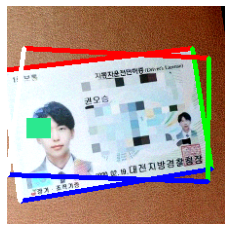

In [ ]:
for image, y in dt:
    image = image[0]
    y_label = y[0][0]
    y_points = y[1][0]
    label, pred_points = model(image[None, ...])
    # print(y_points)
    print(y_points, pred_points)
    print(keras.losses.mse(y_points, pred_points))
    # points = decode_points(pred_points, tf.shape(image))
    image = image.numpy()
    image = (image + 1) * 127.5
    image = draw_points(image.astype(np.uint8), y_points.numpy(), False)

    # points = decode_points(y_points, tf.shape(image))
    image = draw_points(image, pred_points[0].numpy(), False)
    
    plt.imshow(image)
    plt.axis('off')
    plt.plot()
    
    break

In [ ]:
model = keras.models.load_model('asdf')

In [ ]:
model.save('drive/MyDrive/asdf.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive
